# Importing Libraries

In [88]:
import networkx as nx
from networkx.algorithms.community.centrality import girvan_newman
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd
import random

In [5]:
%matplotlib inline

# Loading the Dataset containing Links

In [84]:
# First 5000 edges are considered from the original dataset
edge_df=pd.read_csv('Book_copurchase_5k_edges_connected_graph.csv')
edge_df.head()

,Source,Target
0,1,2
1,1,4
2,1,5
3,1,13
4,2,10


# Constructing Graph and Finding Communities among the Co-Purchages

## 1. Using NetworkX

In [85]:
G=nx.Graph()
G.add_edges_from(edge_df.values.tolist())

In [86]:
# Finding the communities using the Girvan Newman algorithm
communities = girvan_newman(G)
 
node_groups = []
for com in next(communities):
    node_groups.append(list(com))

node_groups

[[1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  25,
  26,
  27,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  46,
  47,
  48,
  49,
  50,
  51,
  52,
  53,
  54,
  55,
  56,
  57,
  58,
  59,
  60,
  61,
  62,
  63,
  64,
  65,
  66,
  67,
  68,
  69,
  70,
  71,
  72,
  73,
  74,
  75,
  76,
  81,
  82,
  83,
  84,
  85,
  86,
  87,
  88,
  89,
  90,
  91,
  92,
  93,
  94,
  95,
  96,
  97,
  98,
  101,
  102,
  103,
  104,
  105,
  106,
  107,
  108,
  109,
  110,
  111,
  112,
  114,
  115,
  116,
  117,
  118,
  119,
  120,
  121,
  127,
  128,
  129,
  130,
  131,
  132,
  133,
  134,
  135,
  136,
  137,
  138,
  139,
  140,
  141,
  142,
  143,
  144,
  145,
  147,
  148,
  149,
  150,
  151,
  152,
  153,
  154,
  155,
  156,
  163,
  164,
  165,
  166,
  167,
  168,
  169,
  170,
  171,
  172,
  173,
  174,
  175,
  176,
  177,
  178,
  179,
 

In [152]:
len(node_groups) # Total number of communities or clusters found is 51

51

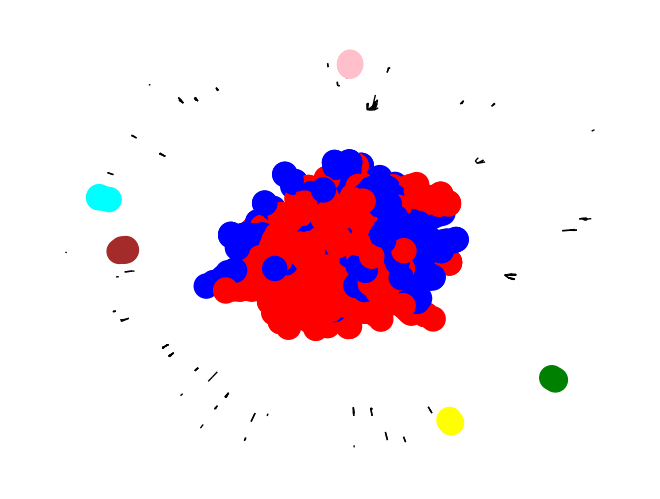

In [153]:
color_map = []

# Taking only 7 groups out of 51
for node in G:
    if node in node_groups[0]:
        color_map.append('red')
    elif node in node_groups[1]:
        color_map.append('blue')
    elif node in node_groups[2]:
        color_map.append('green')
    elif node in node_groups[3]:
        color_map.append('yellow')
    elif node in node_groups[4]:
        color_map.append('brown')
    elif node in node_groups[5]:
        color_map.append('pink')
    elif node in node_groups[6]:
        color_map.append('cyan')
    else:
        color_map.append('#FF000000')
        
# Visualizing Communities represented by different colors
nx.draw(G, node_color=color_map,)
plt.show()

## 2. Finding Communities using igram

In [18]:
import igraph
from igraph import *

In [20]:
# igram indices start from 0, so edge list is transformed
edge_list_igraph = [[y-1 for y in x] for x in edge_list]
edge_list_igraph

[[0, 1],
 [0, 3],
 [0, 4],
 [0, 14],
 [1, 10],
 [1, 11],
 [1, 12],
 [2, 62],
 [2, 63],
 [2, 64],
 [2, 65],
 [2, 66],
 [3, 15],
 [3, 16],
 [3, 18],
 [4, 5],
 [4, 7],
 [4, 8],
 [4, 9],
 [5, 4],
 [5, 7],
 [5, 8],
 [5, 19],
 [7, 12],
 [7, 22],
 [7, 23],
 [9, 4],
 [9, 136],
 [9, 138],
 [10, 5],
 [10, 8],
 [10, 19],
 [10, 24],
 [10, 25],
 [11, 259],
 [11, 260],
 [11, 261],
 [11, 262],
 [11, 263],
 [12, 19],
 [12, 22],
 [12, 139],
 [12, 140],
 [14, 67],
 [14, 68],
 [14, 69],
 [14, 71],
 [15, 3],
 [15, 18],
 [15, 72],
 [15, 74],
 [16, 5],
 [16, 7],
 [16, 29],
 [16, 30],
 [18, 3],
 [18, 15],
 [18, 72],
 [18, 73],
 [18, 74],
 [19, 5],
 [19, 7],
 [19, 22],
 [19, 29],
 [22, 7],
 [22, 12],
 [22, 19],
 [22, 110],
 [22, 141],
 [23, 39],
 [23, 40],
 [23, 42],
 [24, 10],
 [24, 44],
 [24, 45],
 [24, 46],
 [25, 10],
 [25, 264],
 [25, 265],
 [25, 266],
 [25, 267],
 [26, 12],
 [26, 75],
 [26, 76],
 [26, 77],
 [27, 19],
 [27, 78],
 [27, 79],
 [27, 81],
 [28, 142],
 [28, 143],
 [28, 144],
 [28, 145],
 [28, 1

In [32]:
# defining the graph and adding edges & vertices; stored in adjancency list
g2 = Graph()
g2.add_vertices(5000)
g2.add_edges(edge_list_igraph)
print(g2)

IGRAPH U--- 5000 10571 --
+ edges:
   0 --    1    3    4   14
   1 --    0   10   11   12
   2 --   62   63   64   65   66
   3 --    0   15   15   16   18   18   72   73   74  108  109  281  430  628
629 1722 3800 4033
   4 --    0    5    5    7    8    9    9  138  153  611 2020 2554 2771
   5 --    4    4    7    8   10   16   19   19  153  611  667 1220 1493 2071
2163 3287 3488 4368
   6 --
   7 --    4    5   12   16   19   22   22   23   29   39   79   96   98  111
114  163  192  209  225  227  289  301  312  314  449  453  478  503  596  667
682  684  686  718  818 1078 2128 2599 3458 4146
   8 --    4    5   10   29   30  117  138  167 1431 1988 2434 3572
   9 --    4    4  136  136  138  138  481 3459
  10 --    1    5    8   19   24   24   25   25   44   45   46   56   57   87
264  265  266  401  499  500  544 1698 3451 4750
  11 --    1  259  259  260  260  261  261  262  262  263  263  665 1668 4368
  12 --    1    7   19   22   22   26   78  139  139  140  140  182  197 

In [36]:
# Nodes with zero degree are removed from adjacency list
to_delete_ids = [v.index for v in g2.vs if v.degree() == 0]
g2.delete_vertices(to_delete_ids)

In [37]:
print(g2)

IGRAPH U--- 3476 10571 --
+ edges:
   0 --    1    3    4   12
   1 --    0    9   10   11
   2 --   50   51   52   53   54
   3 --    0   13   13   14   15   15   59   60   61   91   92  232  341  478
479 1196 2690 2839
   4 --    0    5    5    6    7    8    8  117  128  464 1401 1814 1954
   5 --    4    4    6    7    9   14   16   16  128  464  505  864 1065 1441
1512 2317 2473 3061
   6 --    4    5   11   14   16   17   17   18   24   32   66   80   81   94
97  136  159  174  188  189  237  246  253  255  359  362  377  397  456  505
515  517  518  544  595  773 1487 1850 2450 2912
   7 --    4    5    9   24   25  100  117  140 1015 1375 1726 2517
   8 --    4    4  116  116  117  117  379 2451
   9 --    1    5    7   16   19   19   20   20   35   36   37   45   46   72
216  217  218  318  393  394  424 1180 2447 3327
  10 --    1  211  211  212  212  213  213  214  214  215  215  503 1166 3061
  11 --    1    6   16   17   17   21   65  118  118  119  119  150  164  165
191 

In [39]:
# created commmunities based on edge betweeness
v = g2.community_edge_betweenness(directed=True)
print(v)

Dendrogram, 3476 elements, 3426 merges


In [40]:
# groupping the nodes into clusters with cluster indices
cluster1 = v.as_clustering()
print(cluster1)

Clustering with 3476 elements and 62 clusters
[ 0] 0, 3, 4, 5, 7, 8, 13, 14, 15, 25, 26, 28, 29, 39, 41, 42, 43, 47, 48, 49,
     59, 60, 61, 68, 69, 74, 75, 90, 91, 92, 104, 105, 106, 107, 114, 115,
     116, 117, 128, 129, 131, 132, 133, 134, 135, 137, 138, 139, 140, 162,
     173, 224, 232, 240, 241, 252, 253, 254, 337, 338, 341, 350, 391, 399,
     440, 462, 464, 465, 466, 468, 469, 470, 478, 479, 513, 514, 515, 516,
     564, 565, 571, 594, 595, 596, 609, 611, 612, 615, 625, 626, 662, 681,
     682, 684, 685, 686, 687, 688, 689, 693, 694, 695, 696, 697, 698, 745,
     747, 750, 751, 766, 768, 769, 776, 777, 778, 783, 785, 792, 793, 841,
     857, 858, 859, 860, 889, 890, 892, 893, 894, 912, 913, 914, 932, 933,
     985, 989, 990, 991, 992, 1015, 1016, 1017, 1018, 1065, 1066, 1067, 1080,
     1110, 1111, 1112, 1121, 1122, 1123, 1124, 1125, 1126, 1127, 1128, 1139,
     1140, 1141, 1142, 1148, 1149, 1163, 1164, 1165, 1196, 1223, 1224, 1243,
     1271, 1272, 1273, 1282, 1283, 1284, 13

In [41]:
# modularity value
cluster1.modularity

0.8639674581401947

In [44]:
# membership list : which cluster each node belongs
cluster1.membership

[0,
 1,
 2,
 0,
 0,
 0,
 3,
 0,
 0,
 1,
 2,
 3,
 3,
 0,
 0,
 0,
 3,
 3,
 4,
 1,
 1,
 1,
 3,
 5,
 2,
 0,
 0,
 5,
 0,
 0,
 6,
 6,
 4,
 4,
 4,
 1,
 1,
 1,
 2,
 0,
 7,
 0,
 0,
 0,
 5,
 1,
 1,
 0,
 0,
 0,
 2,
 2,
 2,
 2,
 2,
 3,
 3,
 3,
 3,
 0,
 0,
 0,
 3,
 3,
 3,
 3,
 3,
 3,
 0,
 0,
 6,
 6,
 1,
 2,
 0,
 0,
 5,
 5,
 5,
 5,
 2,
 2,
 2,
 2,
 3,
 3,
 3,
 3,
 3,
 3,
 0,
 0,
 0,
 3,
 3,
 3,
 6,
 6,
 2,
 8,
 2,
 2,
 3,
 3,
 0,
 0,
 0,
 0,
 3,
 3,
 3,
 8,
 8,
 3,
 0,
 0,
 0,
 0,
 3,
 3,
 3,
 5,
 5,
 5,
 5,
 5,
 3,
 2,
 0,
 0,
 2,
 0,
 0,
 0,
 0,
 0,
 3,
 0,
 0,
 0,
 0,
 9,
 6,
 2,
 2,
 5,
 2,
 2,
 3,
 3,
 3,
 2,
 2,
 2,
 3,
 3,
 8,
 8,
 5,
 5,
 8,
 5,
 0,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 2,
 2,
 2,
 0,
 3,
 6,
 9,
 9,
 9,
 9,
 2,
 3,
 3,
 3,
 3,
 3,
 5,
 5,
 5,
 3,
 3,
 3,
 2,
 3,
 3,
 3,
 3,
 5,
 5,
 5,
 5,
 3,
 2,
 2,
 3,
 5,
 3,
 3,
 2,
 2,
 3,
 2,
 2,
 2,
 2,
 2,
 1,
 1,
 1,
 1,
 3,
 6,
 6,
 6,
 0,
 7,
 7,
 7,
 7,
 2,
 2,
 2,
 0,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 0,
 0,
 5,
 3,
 3,
 3,
 10,
 3,
 3,
 2,

In [46]:
# Assigning differnt colors to the nodes belonging to same cluster
color_palletes = igraph.drawing.colors.ClusterColoringPalette(len(cluster1))
g2.vs['color'] = color_palletes.get_many(cluster1.membership)

In [150]:
# Visualizing the communities present in the graph
visual_style["layout"] = g2.layout_fruchterman_reingold()
visual_style["bbox"] = (300, 300)
visual_style["margin"] = 10

fig, ax = plt.subplots()
fig.set_figwidth(400)
fig.set_figheight(400)
igraph.plot(g2,**visual_style, target=ax)

<AxesSubplot:>

<AxesSubplot:>

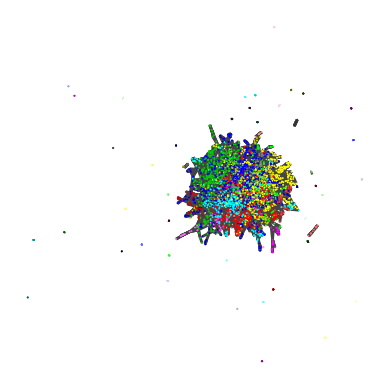

In [142]:
# visualization in another form of layout
fig, ax = plt.subplots()
igraph.plot(g2, layout= g2.layout_fruchterman_reingold(),
            vertex_frame_width=0,
            target = ax)